In [ ]:
from google.colab import drive
from scipy.stats import mode
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
path = "gdrive/MyDrive/Dataset/"

In [ ]:
import os
os.listdir(path)

['Iris.csv',
 'credit_risk_dataset.csv',
 'UCMerced_LandUse.zip',
 'NEU surface defect database.rar',
 'train_titanic.tsv',
 'test_titanic.tsv',
 'loan_final.csv']

In [11]:
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt
import numpy as np
from sklearn import model_selection
from sklearn.model_selection import train_test_split
from scipy import stats
from sklearn.metrics import classification_report
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn import tree
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.calibration import calibration_curve
from xgboost import plot_importance

In [ ]:
data = pd.read_csv(path+"loan_final.csv")

**Deskripsi Data**

In [ ]:
data.head()

,id,year,issue_d,final_d,emp_length_int,home_ownership,home_ownership_cat,income_category,annual_inc,income_cat,loan_amount,term,term_cat,application_type,application_type_cat,purpose,purpose_cat,interest_payments,interest_payment_cat,loan_condition,loan_condition_cat,interest_rate,grade,grade_cat,dti,total_pymnt,total_rec_prncp,recoveries,installment,region
0,1077501,2011,01/12/2011,1012015,10.0,RENT,1,Low,24000,1,5000,36 months,1,INDIVIDUAL,1,credit_card,1,Low,1,Good Loan,0,10.65,B,2,27.65,5861.071414,5000.00,0.00,162.87,munster
1,1077430,2011,01/12/2011,1042013,0.5,RENT,1,Low,30000,1,2500,60 months,2,INDIVIDUAL,1,car,2,High,2,Bad Loan,1,15.27,C,3,1.00,1008.710000,456.46,117.08,59.83,leinster
2,1077175,2011,01/12/2011,1062014,10.0,RENT,1,Low,12252,1,2400,36 months,1,INDIVIDUAL,1,small_business,3,High,2,Good Loan,0,15.96,C,3,8.72,3003.653644,2400.00,0.00,84.33,cannught
3,1076863,2011,01/12/2011,1012015,10.0,RENT,1,Low,49200,1,10000,36 months,1,INDIVIDUAL,1,other,4,High,2,Good Loan,0,13.49,C,3,20.00,12226.302210,10000.00,0.00,339.31,ulster
4,1075358,2011,01/12/2011,1012016,1.0,RENT,1,Low,80000,1,3000,60 months,2,INDIVIDUAL,1,other,4,Low,1,Good Loan,0,12.69,B,2,17.94,3242.170000,2233.10,0.00,67.79,ulster


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 887379 entries, 0 to 887378
Data columns (total 30 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    887379 non-null  int64  
 1   year                  887379 non-null  int64  
 2   issue_d               887379 non-null  object 
 3   final_d               887379 non-null  int64  
 4   emp_length_int        887379 non-null  float64
 5   home_ownership        887379 non-null  object 
 6   home_ownership_cat    887379 non-null  int64  
 7   income_category       887379 non-null  object 
 8   annual_inc            887379 non-null  int64  
 9   income_cat            887379 non-null  int64  
 10  loan_amount           887379 non-null  int64  
 11  term                  887379 non-null  object 
 12  term_cat              887379 non-null  int64  
 13  application_type      887379 non-null  object 
 14  application_type_cat  887379 non-null  int64  
 15  

**Preprocessing Data**

In [ ]:
data['term'] = pd.to_numeric(data['term'].replace(" months", "", regex=True))
data['emp_length_int'] = data['emp_length_int'].astype(int)

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 887379 entries, 0 to 887378
Data columns (total 30 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    887379 non-null  int64  
 1   year                  887379 non-null  int64  
 2   issue_d               887379 non-null  object 
 3   final_d               887379 non-null  int64  
 4   emp_length_int        887379 non-null  int64  
 5   home_ownership        887379 non-null  object 
 6   home_ownership_cat    887379 non-null  int64  
 7   income_category       887379 non-null  object 
 8   annual_inc            887379 non-null  int64  
 9   income_cat            887379 non-null  int64  
 10  loan_amount           887379 non-null  int64  
 11  term                  887379 non-null  int64  
 12  term_cat              887379 non-null  int64  
 13  application_type      887379 non-null  object 
 14  application_type_cat  887379 non-null  int64  
 15  

In [ ]:
data.head()

,id,year,issue_d,final_d,emp_length_int,home_ownership,home_ownership_cat,income_category,annual_inc,income_cat,loan_amount,term,term_cat,application_type,application_type_cat,purpose,purpose_cat,interest_payments,interest_payment_cat,loan_condition,loan_condition_cat,interest_rate,grade,grade_cat,dti,total_pymnt,total_rec_prncp,recoveries,installment,region
0,1077501,2011,01/12/2011,1012015,10,RENT,1,Low,24000,1,5000,36,1,INDIVIDUAL,1,credit_card,1,Low,1,Good Loan,0,10.65,B,2,27.65,5861.071414,5000.00,0.00,162.87,munster
1,1077430,2011,01/12/2011,1042013,0,RENT,1,Low,30000,1,2500,60,2,INDIVIDUAL,1,car,2,High,2,Bad Loan,1,15.27,C,3,1.00,1008.710000,456.46,117.08,59.83,leinster
2,1077175,2011,01/12/2011,1062014,10,RENT,1,Low,12252,1,2400,36,1,INDIVIDUAL,1,small_business,3,High,2,Good Loan,0,15.96,C,3,8.72,3003.653644,2400.00,0.00,84.33,cannught
3,1076863,2011,01/12/2011,1012015,10,RENT,1,Low,49200,1,10000,36,1,INDIVIDUAL,1,other,4,High,2,Good Loan,0,13.49,C,3,20.00,12226.302210,10000.00,0.00,339.31,ulster
4,1075358,2011,01/12/2011,1012016,1,RENT,1,Low,80000,1,3000,60,2,INDIVIDUAL,1,other,4,Low,1,Good Loan,0,12.69,B,2,17.94,3242.170000,2233.10,0.00,67.79,ulster


In [ ]:
data.isnull().sum()

id                      0
year                    0
issue_d                 0
final_d                 0
emp_length_int          0
home_ownership          0
home_ownership_cat      0
income_category         0
annual_inc              0
income_cat              0
loan_amount             0
term                    0
term_cat                0
application_type        0
application_type_cat    0
purpose                 0
purpose_cat             0
interest_payments       0
interest_payment_cat    0
loan_condition          0
loan_condition_cat      0
interest_rate           0
grade                   0
grade_cat               0
dti                     0
total_pymnt             0
total_rec_prncp         0
recoveries              0
installment             0
region                  0
dtype: int64

In [ ]:
data.describe()

,id,year,final_d,emp_length_int,home_ownership_cat,annual_inc,income_cat,loan_amount,term,term_cat,application_type_cat,purpose_cat,interest_payment_cat,loan_condition_cat,interest_rate,grade_cat,dti,total_pymnt,total_rec_prncp,recoveries,installment
count,8.873790e+05,887379.000000,8.873790e+05,887379.000000,887379.000000,8.873790e+05,887379.000000,887379.000000,887379.000000,887379.000000,887379.000000,887379.000000,887379.000000,887379.000000,887379.000000,887379.000000,887379.000000,887379.000000,887379.000000,887379.000000,887379.000000
mean,3.246513e+07,2014.021761,1.047089e+06,6.008256,2.099130,7.502759e+04,1.196702,14755.264605,43.201090,1.300045,1.000576,4.874621,1.475629,0.075987,13.246740,2.798403,18.157039,7558.826684,5757.706424,45.919243,436.717127
std,2.282734e+07,1.261741,4.555149e+04,3.572360,0.944839,6.469815e+04,0.442542,8435.455601,10.998663,0.458278,0.023990,2.381156,0.499406,0.264977,4.381867,1.312599,17.190626,7871.243336,6625.441046,409.693874,244.186593
min,5.473400e+04,2007.000000,1.012008e+06,0.000000,1.000000,0.000000e+00,1.000000,500.000000,36.000000,1.000000,1.000000,1.000000,1.000000,0.000000,5.320000,1.000000,0.000000,0.000000,0.000000,0.000000,15.670000
25%,9.206643e+06,2013.000000,1.012016e+06,3.000000,1.000000,4.500000e+04,1.000000,8000.000000,36.000000,1.000000,1.000000,3.000000,1.000000,0.000000,9.990000,2.000000,11.910000,1914.590000,1200.570000,0.000000,260.705000
50%,3.443327e+07,2014.000000,1.012016e+06,6.000000,3.000000,6.500000e+04,1.000000,13000.000000,36.000000,1.000000,1.000000,6.000000,1.000000,0.000000,12.990000,3.000000,17.650000,4894.999117,3215.320000,0.000000,382.550000
75%,5.490814e+07,2015.000000,1.092015e+06,10.000000,3.000000,9.000000e+04,1.000000,20000.000000,60.000000,2.000000,1.000000,6.000000,2.000000,0.000000,16.200000,4.000000,23.950000,10616.814230,8000.000000,0.000000,572.600000
max,6.861706e+07,2015.000000,1.122015e+06,10.000000,6.000000,9.500000e+06,3.000000,35000.000000,60.000000,2.000000,2.000000,14.000000,2.000000,1.000000,28.990000,7.000000,9999.000000,57777.579870,35000.030000,33520.270000,1445.460000


**Visualisasi Data**

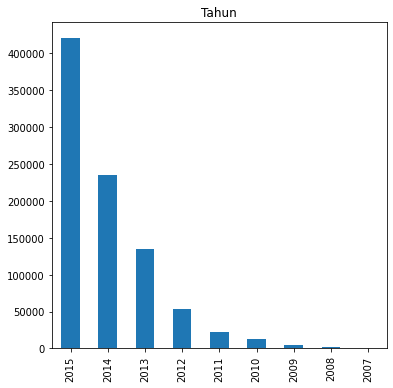

In [ ]:
data.year.value_counts().plot.bar(figsize=(6, 6), title="Tahun")

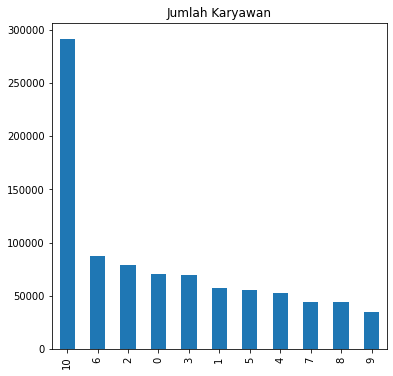

In [ ]:
data.emp_length_int.value_counts().plot.bar(figsize=(6, 6), title="Jumlah Karyawan")

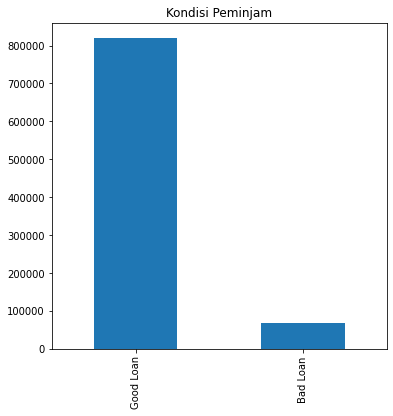

In [ ]:
data.loan_condition.value_counts().plot.bar(figsize=(6, 6), title="Kondisi Peminjam")

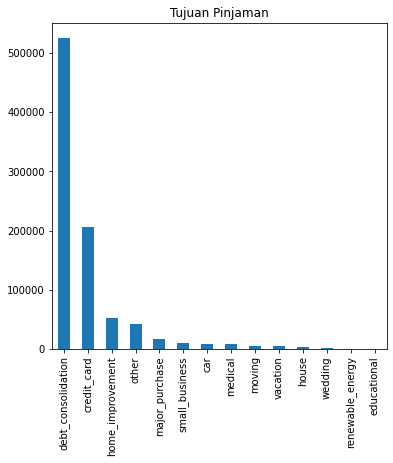

In [ ]:
data.purpose.value_counts().plot.bar(figsize=(6, 6), title="Tujuan Pinjaman")

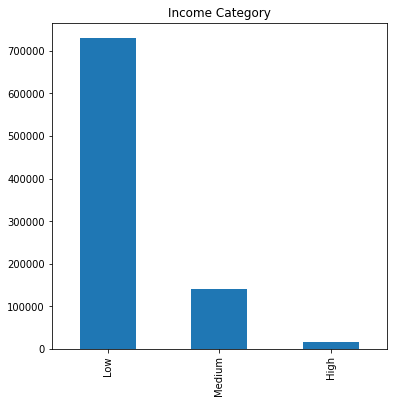

In [ ]:
data.income_category.value_counts().plot.bar(figsize=(6, 6), title="Income Category")

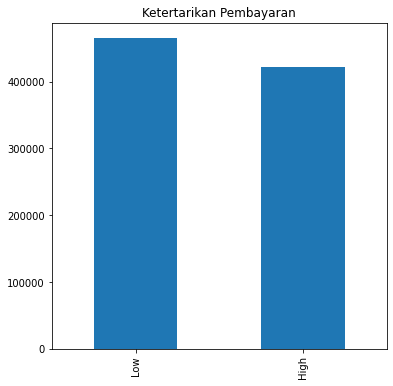

In [ ]:
data.interest_payments.value_counts().plot.bar(figsize=(6, 6), title="Ketertarikan Pembayaran")

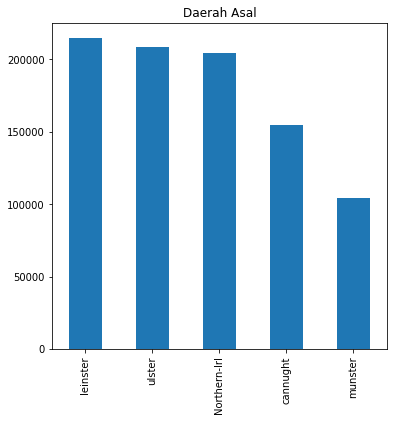

In [ ]:
data.region.value_counts().plot.bar(figsize=(6, 6), title="Daerah Asal")

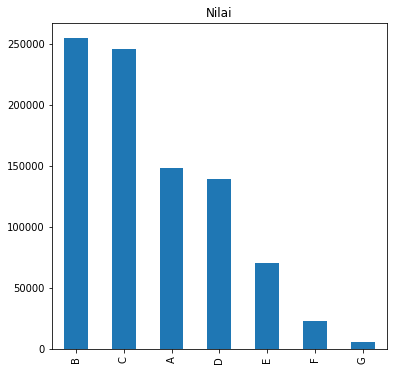

In [ ]:
data.grade.value_counts().plot.bar(figsize=(6, 6), title="Nilai")

In [ ]:
fig = px.scatter_matrix(data, dimensions=['year', 'emp_length_int', 'annual_inc', 'loan_amount', 'total_pymnt'], height = 800, width = 800, color_continuous_scale=px.colors.diverging.Tealrose, labels={col:col.replace('_', ' ') for col in data.columns}, color="grade")
fig.show()

Output hidden; open in https://colab.research.google.com to view.

Jumlah yang dipinjam terhadap status peminjam berdasarkan kategori peminjam

In [ ]:
fig = px.box(data, x="loan_condition", y= "loan_amount", color="grade", color_discrete_sequence=px.colors.qualitative.Dark24, labels={col:col.replace('_', ' ') for col in data.columns})
fig.update_layout()
fig.show()

Output hidden; open in https://colab.research.google.com to view.

Jumlah yang dibayar terhadap status peminjam berdasarkan kategori peminjam

In [ ]:
fig = px.box(data, x="loan_condition", y="installment", color="grade", color_discrete_sequence=px.colors.qualitative.Dark24, labels={col:col.replace('_', ' ') for col in data.columns})
fig.update_layout()
fig.show()

Output hidden; open in https://colab.research.google.com to view.

Jumlah yang dibayar terhadap status peminjam berdasarkan kategori peminjam

In [ ]:
fig = px.bar(data, x="purpose", y="loan_amount", color="grade", color_discrete_sequence=px.colors.qualitative.Dark24, labels={col:col.replace('_', ' ') for col in data.columns})
fig.update_layout()
fig.show()

**Korelasi Data**

Sebelum preprocessing

In [ ]:
spearman = data.corr(method="spearman")
spearman

,id,year,final_d,emp_length_int,home_ownership_cat,annual_inc,income_cat,loan_amount,term,term_cat,application_type_cat,purpose_cat,interest_payment_cat,loan_condition_cat,interest_rate,grade_cat,dti,total_pymnt,total_rec_prncp,recoveries,installment
id,1.000000,0.930662,-0.235789,0.018838,0.004646,0.046790,0.038199,0.068488,0.070035,0.070035,0.037172,-0.015063,-0.110756,-0.190828,-0.136145,0.001262,0.126885,-0.749358,-0.748435,-0.194676,0.031222
year,0.930662,1.000000,-0.217094,0.021596,0.004053,0.046377,0.037853,0.077978,0.074721,0.074721,0.023413,-0.013924,-0.097354,-0.182639,-0.125184,0.010173,0.129902,-0.664150,-0.664923,-0.200716,0.041679
final_d,-0.235789,-0.217094,1.000000,-0.010246,-0.004197,-0.020068,-0.016177,-0.029856,-0.033751,-0.033751,-0.010232,0.015434,0.044046,0.190818,0.054080,0.020980,-0.036563,0.212276,0.223848,0.080928,-0.013806
emp_length_int,0.018838,0.021596,-0.010246,1.000000,0.204861,0.136199,0.044518,0.108646,0.068800,0.068800,0.000395,0.025338,0.007357,-0.016737,0.007256,0.003384,0.041532,0.045635,0.033201,-0.014596,0.096884
home_ownership_cat,0.004646,0.004053,-0.004197,0.204861,1.000000,0.270953,0.161874,0.196003,0.110102,0.110102,0.009076,0.058892,-0.050215,-0.037095,-0.066957,-0.067428,0.000467,0.093566,0.082254,-0.023036,0.167670
annual_inc,0.046790,0.046377,-0.020068,0.136199,0.270953,1.000000,0.663520,0.504491,0.134925,0.134925,-0.009810,0.025806,-0.098243,-0.056446,-0.122832,-0.114979,-0.210365,0.216267,0.195259,-0.035939,0.484141
income_cat,0.038199,0.037853,-0.016177,0.044518,0.161874,0.663520,1.000000,0.320460,0.047456,0.047456,-0.006023,0.015952,-0.068717,-0.038220,-0.088823,-0.081382,-0.189331,0.127764,0.119502,-0.024918,0.311688
loan_amount,0.068488,0.077978,-0.029856,0.108646,0.196003,0.504491,0.320460,1.000000,0.440779,0.440779,0.012503,-0.031622,0.101840,0.003267,0.116829,0.119229,0.056072,0.419696,0.324379,-0.001651,0.960305
term,0.070035,0.074721,-0.033751,0.068800,0.110102,0.134925,0.047456,0.440779,1.000000,1.000000,0.012165,0.032250,0.351261,0.039591,0.415687,0.430676,0.105601,0.059784,-0.079923,0.024328,0.215333
term_cat,0.070035,0.074721,-0.033751,0.068800,0.110102,0.134925,0.047456,0.440779,1.000000,1.000000,0.012165,0.032250,0.351261,0.039591,0.415687,0.430676,0.105601,0.059784,-0.079923,0.024328,0.215333


In [ ]:
pearson = data.corr(method="pearson")
pearson

,id,year,final_d,emp_length_int,home_ownership_cat,annual_inc,income_cat,loan_amount,term,term_cat,application_type_cat,purpose_cat,interest_payment_cat,loan_condition_cat,interest_rate,grade_cat,dti,total_pymnt,total_rec_prncp,recoveries,installment
id,1.000000,0.820601,-0.199171,0.011956,0.001403,0.033990,0.037234,0.063803,0.068539,0.068539,0.034827,-0.020559,-0.120553,-0.190691,-0.142963,-0.007915,0.067781,-0.597261,-0.556328,-0.114386,0.025347
year,0.820601,1.000000,-0.184786,0.048612,0.019558,0.035911,0.037992,0.103722,0.081026,0.081026,0.018610,-0.036398,-0.049023,-0.165122,-0.063632,0.016914,0.078530,-0.464010,-0.443454,-0.100694,0.075157
final_d,-0.199171,-0.184786,1.000000,-0.008667,-0.003452,-0.013948,-0.015349,-0.023783,-0.027823,-0.027823,-0.009521,0.016936,0.041204,0.178373,0.049275,0.023021,-0.017203,0.180982,0.199173,0.041700,-0.008882
emp_length_int,0.011956,0.048612,-0.008667,1.000000,0.204240,0.063318,0.039070,0.103522,0.067329,0.067329,0.000457,0.019312,0.007790,-0.015819,0.009064,0.004315,0.020662,0.049625,0.037043,0.004199,0.088347
home_ownership_cat,0.001403,0.019558,-0.003452,0.204240,1.000000,0.154832,0.156441,0.196269,0.109770,0.109770,0.009016,0.022575,-0.050201,-0.037253,-0.064271,-0.062029,0.001117,0.105861,0.095706,0.003483,0.163354
annual_inc,0.033990,0.035911,-0.013948,0.063318,0.154832,1.000000,0.630750,0.332697,0.058360,0.058360,-0.006071,0.004787,-0.063125,-0.034142,-0.072785,-0.064426,-0.087409,0.160879,0.149993,0.007717,0.326181
income_cat,0.037234,0.037992,-0.015349,0.039070,0.156441,0.630750,1.000000,0.359688,0.042310,0.042310,-0.005893,0.002355,-0.066881,-0.037397,-0.080198,-0.070596,-0.094228,0.172401,0.162372,0.005564,0.355886
loan_amount,0.063803,0.103722,-0.023783,0.103522,0.196269,0.332697,0.359688,1.000000,0.411717,0.411717,0.013192,-0.037038,0.112867,0.003512,0.145023,0.150873,0.020675,0.474626,0.390473,0.073150,0.944977
term,0.068539,0.081026,-0.027823,0.067329,0.109770,0.058360,0.042310,0.411717,1.000000,1.000000,0.012165,0.029277,0.351261,0.039591,0.428058,0.442701,0.051077,0.083078,-0.025831,0.057290,0.144984
term_cat,0.068539,0.081026,-0.027823,0.067329,0.109770,0.058360,0.042310,0.411717,1.000000,1.000000,0.012165,0.029277,0.351261,0.039591,0.428058,0.442701,0.051077,0.083078,-0.025831,0.057290,0.144984


Sesudah preprocessing

In [ ]:
data_1 = pd.read_csv(path+"loan_final.csv")
data_1.drop(['id', 'issue_d', 'final_d', 'home_ownership','loan_condition', 'term_cat', 
               'interest_payments', 'purpose', 'home_ownership_cat', 'income_category', 'application_type', 
               'application_type_cat', 'purpose_cat', 'grade', 'grade_cat'], axis = 1, inplace=True)

In [ ]:
data_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 887379 entries, 0 to 887378
Data columns (total 15 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   year                  887379 non-null  int64  
 1   emp_length_int        887379 non-null  float64
 2   annual_inc            887379 non-null  int64  
 3   income_cat            887379 non-null  int64  
 4   loan_amount           887379 non-null  int64  
 5   term                  887379 non-null  object 
 6   interest_payment_cat  887379 non-null  int64  
 7   loan_condition_cat    887379 non-null  int64  
 8   interest_rate         887379 non-null  float64
 9   dti                   887379 non-null  float64
 10  total_pymnt           887379 non-null  float64
 11  total_rec_prncp       887379 non-null  float64
 12  recoveries            887379 non-null  float64
 13  installment           887379 non-null  float64
 14  region                887379 non-null  object 
dtype

In [ ]:
spearman = data_1.corr(method="spearman")
spearman

,year,emp_length_int,annual_inc,income_cat,loan_amount,interest_payment_cat,loan_condition_cat,interest_rate,dti,total_pymnt,total_rec_prncp,recoveries,installment
year,1.000000,0.023010,0.046377,0.037853,0.077978,-0.097354,-0.182639,-0.125184,0.129902,-0.664150,-0.664923,-0.200716,0.041679
emp_length_int,0.023010,1.000000,0.133234,0.043124,0.107056,0.007294,-0.016839,0.007158,0.042274,0.043702,0.031392,-0.014909,0.095411
annual_inc,0.046377,0.133234,1.000000,0.663520,0.504491,-0.098243,-0.056446,-0.122832,-0.210365,0.216267,0.195259,-0.035939,0.484141
income_cat,0.037853,0.043124,0.663520,1.000000,0.320460,-0.068717,-0.038220,-0.088823,-0.189331,0.127764,0.119502,-0.024918,0.311688
loan_amount,0.077978,0.107056,0.504491,0.320460,1.000000,0.101840,0.003267,0.116829,0.056072,0.419696,0.324379,-0.001651,0.960305
interest_payment_cat,-0.097354,0.007294,-0.098243,-0.068717,0.101840,1.000000,0.140519,0.865105,0.139256,0.125737,0.020369,0.089132,0.093880
loan_condition_cat,-0.182639,-0.016839,-0.056446,-0.038220,0.003267,0.140519,1.000000,0.170301,0.024684,-0.006157,-0.070682,0.589696,0.014441
interest_rate,-0.125184,0.007158,-0.122832,-0.088823,0.116829,0.865105,0.170301,1.000000,0.164973,0.151513,0.023407,0.109961,0.112409
dti,0.129902,0.042274,-0.210365,-0.189331,0.056072,0.139256,0.024684,0.164973,1.000000,-0.083429,-0.115026,-0.008361,0.048738
total_pymnt,-0.664150,0.043702,0.216267,0.127764,0.419696,0.125737,-0.006157,0.151513,-0.083429,1.000000,0.976703,0.029104,0.463941


In [ ]:
pearson = data_1.corr(method="pearson")
pearson

,year,emp_length_int,annual_inc,income_cat,loan_amount,interest_payment_cat,loan_condition_cat,interest_rate,dti,total_pymnt,total_rec_prncp,recoveries,installment
year,1.000000,0.048980,0.035911,0.037992,0.103722,-0.049023,-0.165122,-0.063632,0.078530,-0.464010,-0.443454,-0.100694,0.075157
emp_length_int,0.048980,1.000000,0.063382,0.039226,0.103898,0.007701,-0.015821,0.008943,0.020660,0.049354,0.036753,0.004163,0.088634
annual_inc,0.035911,0.063382,1.000000,0.630750,0.332697,-0.063125,-0.034142,-0.072785,-0.087409,0.160879,0.149993,0.007717,0.326181
income_cat,0.037992,0.039226,0.630750,1.000000,0.359688,-0.066881,-0.037397,-0.080198,-0.094228,0.172401,0.162372,0.005564,0.355886
loan_amount,0.103722,0.103898,0.332697,0.359688,1.000000,0.112867,0.003512,0.145023,0.020675,0.474626,0.390473,0.073150,0.944977
interest_payment_cat,-0.049023,0.007701,-0.063125,-0.066881,0.112867,1.000000,0.140519,0.802237,0.070369,0.129440,0.039203,0.076371,0.098348
loan_condition_cat,-0.165122,-0.015821,-0.034142,-0.037397,0.003512,0.140519,1.000000,0.175450,0.009961,-0.042515,-0.095991,0.390846,0.014124
interest_rate,-0.063632,0.008943,-0.072785,-0.080198,0.145023,0.802237,0.175450,1.000000,0.079903,0.170506,0.054975,0.106840,0.133075
dti,0.078530,0.020660,-0.087409,-0.094228,0.020675,0.070369,0.009961,0.079903,1.000000,-0.041529,-0.052056,0.001162,0.014333
total_pymnt,-0.464010,0.049354,0.160879,0.172401,0.474626,0.129440,-0.042515,0.170506,-0.041529,1.000000,0.970043,0.038361,0.514954


**Preprocessing Data untuk Training dan Testing**

Pembagian Independent Variable dan Dependent Variable

In [ ]:
Y = data['grade_cat']
X = data.drop(['id', 'issue_d', 'final_d', 'home_ownership','loan_condition', 'term_cat', 
               'interest_payments', 'purpose', 'home_ownership_cat', 'income_category', 'application_type', 
               'application_type_cat', 'purpose_cat', 'grade', 'grade_cat'], axis = 1)

data['region'] = data['region'].astype('category')
data['region'] = data['region'].cat.codes

KeyError: ignored

Dependent Variable

In [ ]:
Y

NameError: ignored

Independent Variable

In [ ]:
X

Pembagian Data Training dan Data Testing

In [ ]:
x_train, x_test, y_train, y_test = model_selection.train_test_split(X, Y, random_state=0, test_size=.30)

**Hasil Training dan Testing**

In [ ]:
def model_function(model, name='Judul'):
  model.fit(x_train, y_train)
  pred = model.predict(x_test)
  pred_prob = model.predict_proba(x_test)
  print('                   ', name, '\n', classification_report(y_test, pred))


In [ ]:
knn = KNeighborsClassifier(n_neighbors=151)
model_function(knn, name='KNN')
#Logistic Regression
lg = LogisticRegression(random_state = 0)
model_function(lg, 'Logistic Regression')
#XGB
xgb = XGBClassifier(n_estimators=1000, learning_rate=0.05)
model_function(xgb, 'XGBoost')

In [ ]:
gnb = GaussianNB()
model_function(gnb, 'Naive Bayes')
rf = RandomForestClassifier(max_depth=5, random_state=0)
model_function(rf, "Random Foreste")